In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
from tqdm import tqdm
import torch
import random
import torchvision
import numpy as np
import pandas as pd
import seaborn as sns
from torchvision import models
from collections import Counter
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
from IPython.display import display
from torchvision.ops import box_iou
from torchvision import transforms as T
from sklearn.metrics import confusion_matrix
from sklearn.metrics import average_precision_score
from sklearn.model_selection import train_test_split
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import FasterRCNN_ResNet50_FPN_Weights


# Hyperparameters.
EPOCH = 4
CONF_TRESHOLD = 0.20

device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
#!pip uninstall torchvision -y
#!pip3 install --upgrade torchvision==0.12

In [ ]:
class CustDat(torch.utils.data.Dataset):
  def __init__(self, df, unique_imgs, indices):
    self.df = df
    self.unique_imgs = unique_imgs
    self.indices= indices

  def __len__(self):
    return len(self.indices)

  def __getitem__(self, idx):
    image_name= self.unique_imgs[self.indices[idx]]
    boxes= self.df[self.df.image == image_name].values[:, 1:].astype("float")
    img = Image.open("/content/drive/MyDrive/dataset/data/training_images/" + image_name ).convert('RGB')
    labels = torch.ones((boxes.shape[0]), dtype = torch.int64)
    target ={}
    target["boxes"] = torch.tensor (boxes)
    target["labels"] = labels
    return T.ToTensor() (img), target

In [ ]:

model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights= 'FasterRCNN_ResNet50_FPN_Weights.COCO_V1')
#model = torchvision.models.detection.fasterrcnn_resnet50_fpn_v2(weights= 'FasterRCNN_ResNet50_FPN_V2_Weights.COCO_V1')

num_classes = 2
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 98.3MB/s]


In [ ]:
# Transformations.
def get_transform(train):
    transforms = []
    transforms.append(T.ToTensor())
    if train:
        # If you want, many different Data Augmentation
        # options are available for training phase.

        # transforms.append(T.RandomHorizontalFlip(0.5))
        # RandomHorizontalFlip is one of them, but you may want to see also:
        #   ColorJitter
        #   RandomGrayscale
        #   RandomAffine
        pass
    return T.Compose(transforms)

# Utils for train/test DataLoaders.
def collate_fn(batch):
    return tuple(zip(*batch))
def custom_collate(data):
  return data

In [ ]:
dataset= pd.read_csv("/content/drive/MyDrive/dataset/data/train_solution_bounding_boxes (1).csv")

unique_imgs=dataset.image.unique()

train_inds,test_inds=train_test_split(range(unique_imgs.shape[0]),test_size=0.1) # 10% test size

train_dl=torch.utils.data.DataLoader(CustDat(dataset,unique_imgs,train_inds),
                                     batch_size=8,
                                     shuffle=True,
                                     collate_fn=custom_collate,
                                     pin_memory=True if torch.cuda.is_available() else False)

test_dl=torch.utils.data.DataLoader(CustDat(dataset,unique_imgs,test_inds),
                                     batch_size=8,
                                     shuffle=True,
                                     collate_fn=custom_collate,
                                     pin_memory=True if torch.cuda.is_available() else False)

model.to(device) # Send model to GPU if available.


params = [p for p in model.parameters() if p.requires_grad] # Get all parameters that require grad.

optimizer= torch.optim.SGD(
    params,
    lr=0.001,
    momentum=0.9,
    weight_decay=0.0005
)

lr_scheduler = torch.optim.lr_scheduler.StepLR(
    optimizer,
    step_size=3,
    gamma=0.1
)

In [ ]:
# ------------------- Training step -------------------
print(f"Start training on {device} [...]")

def train_epoch(model, optimizer, data_loader, device, epoch):
        model.train()
        epoch_loss = 0
        for data in (tepoch :=tqdm(data_loader)):
            tepoch.set_description(f"Epoch {epoch}")

            imgs = list(d[0].to(device) for d in data) # Send imgs to GPU if available.
            targets = [{boxes: labels.to(device) for boxes, labels in d[1].items()} for d in data] # Send targets to GPU if available.


            loss_dict = model(imgs, targets) # Forward pass.
            loss = sum(v for v in loss_dict.values()) # Compute loss.


            epoch_loss += loss.cpu().detach().numpy() # Accumulate loss.

            optimizer.zero_grad() # Reset gradients.
            loss.backward() # Backward pass.
            optimizer.step() # Update model parameters.


            tepoch.set_postfix(epoch_loss=epoch_loss.item())


            # Delete loss object to free some memory.
            del loss
            # and free cache
            torch.cuda.empty_cache()

for epochs in range (EPOCH):
    train_epoch(model, optimizer, train_dl, device, epochs) # Train model.
    lr_scheduler.step() # Update learning rate.

Start training on cpu [...]


Epoch 2:  68%|██████▊   | 27/40 [1:42:03<48:41, 224.76s/it, epoch_loss=3.63]

In [ ]:
def compute_ap(gt_boxes, gt_labels, pred_boxes, pred_scores, iou_threshold=0.40, class_label=1, device='cpu'):

    # Sort predictions by score
    sort_idx = torch.argsort(pred_scores, descending=True)
    pred_boxes = pred_boxes[sort_idx]
    pred_scores = pred_scores[sort_idx]
    print(gt_labels)
    # Compute IoU between predicted and ground truth boxes
    iou = box_iou(pred_boxes, gt_boxes)
    print(iou)
    # Find the best matching ground truth box for each prediction
    match_idx = iou.argmax(dim=1)
    print(match_idx)
    match_iou = iou[range(iou.shape[0]), match_idx]
    print(match_iou)

    # Initialize true positive and false positive arrays
    tp = torch.zeros_like(pred_scores)
    fp = torch.zeros_like(pred_scores)

    # Keep track of which ground truth boxes have already been matched
    matched = torch.zeros(match_iou.shape[0], dtype=torch.bool)

    # Initialize an empty list to collect true labels and predicted labels
    true_labels = []
    predicted_labels = []
    threshold=0.55

    # Loop over predictions
    for i in range(pred_scores.shape[0]):
        # If the prediction matches a ground truth box with IoU above the threshold
        if match_iou[i] >= iou_threshold:
            # If the ground truth box has not already been matched
            if not matched[match_idx[i]]:
                # True positive
                tp[i] = 1
                matched[match_idx[i]] = True
            else:
                # False positive (duplicate detection)
                fp[i] = 1
        else:
            # False positive
            fp[i] = 1
        # Append the true label and predicted label to the lists
        #true_labels.append(int(gt_labels[match_idx[i]].cpu().numpy()))
        true_labels = [1 if condition else 0 for condition in matched]
        predicted_labels.append(int(pred_scores[i] > threshold))


    # Convert the lists to numpy arrays
    true_labels = np.array(true_labels)
    predicted_labels = np.array(predicted_labels)

    # Compute the confusion matrix
    cm = confusion_matrix(true_labels, predicted_labels)

    # Plot the confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="YlGnBu")
    plt.xlabel("Predicted Labels")
    plt.ylabel("True Labels")
    plt.title("Confusion Matrix")
    plt.show()
   #------------------- Precision and Average Precision -------------------

    # Calculate TP, FP, and FN
    tp_cumsum = torch.sum(tp).item()
    fp_cumsum = torch.sum(fp).item()
    fn_cumsum = gt_boxes.shape[0] - tp_cumsum  # Total ground truth boxes - True Positives

    # Calculate precision and Average Precision
    precision = tp_cumsum / (tp_cumsum + fp_cumsum)
    ap = average_precision_score(true_labels, predicted_labels)


    print("Precision:", precision)
    print("Average precision:", ap)

    return ap,precision



In [ ]:
def disp_imgs(dl):
    precision_list = []
    ap_list = []
    for data in dl:
        length = len(data)
        i=0
        for i in range(len(data)):
            imgs = data[i][0]
            targets = data[i][1]
            boxes = targets['boxes']
            boxes = boxes.type(torch.int)
            labels = targets['labels']
            i+=1

            output = model([imgs.to(device)])
            out_bbox = output[0]["boxes"]
            out_scores = output[0]["scores"]


            #Apply confidence threshold to filter out less confident predictions
            confidence_keep = out_scores >= CONF_TRESHOLD
            out_bbox = out_bbox[confidence_keep]
            out_scores = out_scores[confidence_keep]

            keep = torchvision.ops.nms(out_bbox, out_scores, 0.40) # Apply NMS to further filter out predictions.

            im = (imgs.permute(1, 2, 0).cpu().detach().numpy() * 255).astype('uint8')
            vsample = Image.fromarray(im)
            draw = ImageDraw.Draw(vsample)

            for box, score in zip(out_bbox[keep],out_scores[keep]):  # Draw rectangles and confidence scores.
                draw.rectangle(list(box), fill=None, outline="red")
                draw.text((box[0], box[1]), f"Conf: {score:.2f}", fill="white")
            for box in boxes:       # Draw ground truth bounding boxes.
                draw.rectangle(list(box), fill=None, outline="green")
            display(vsample)

            result  = compute_ap(boxes.to(device), labels.to(device), out_bbox[keep].to(device), out_scores[keep].to(device), class_label=1, device=device) # Compute AP, precision.

            ap, precision = result[0], result[1]
            precision_list.append(precision)
            ap_list.append(ap)

    print("precision_mean: ", np.mean(precision_list))
    print("ap_mean: " , np.mean(ap_list))

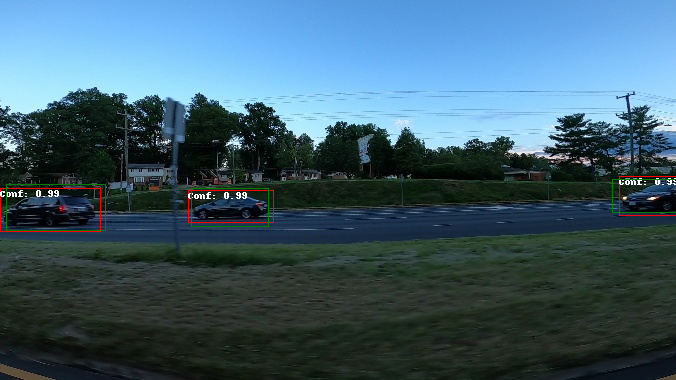

tensor([1, 1, 1], device='cuda:0')
tensor([[0.0000, 0.0000, 0.7676],
        [0.7938, 0.0000, 0.0000],
        [0.0000, 0.7813, 0.0000]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([2, 0, 1], device='cuda:0')
tensor([0.7676, 0.7938, 0.7813], device='cuda:0', grad_fn=<IndexBackward0>)


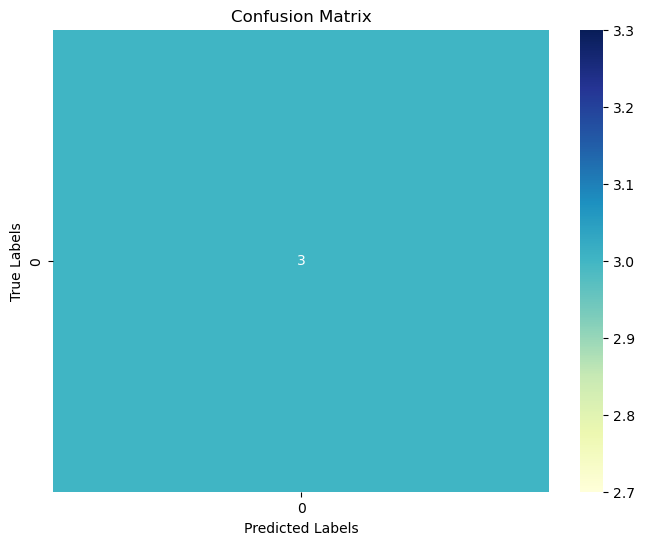

Precision: 1.0
Average precision: 1.0


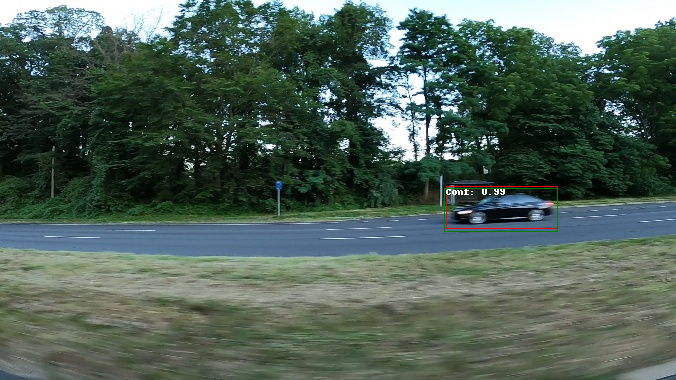

tensor([1], device='cuda:0')
tensor([[0.8947]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8947], device='cuda:0', grad_fn=<IndexBackward0>)


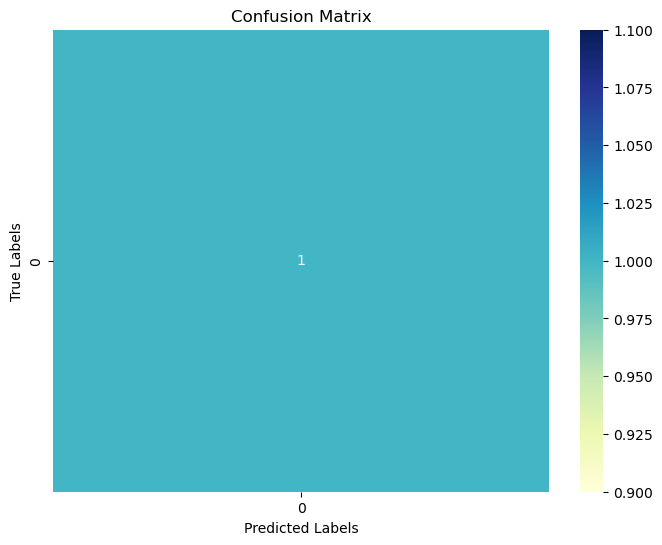

Precision: 1.0
Average precision: 1.0


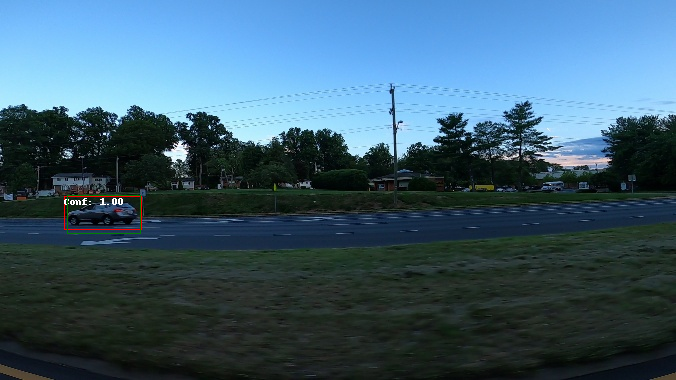

tensor([1], device='cuda:0')
tensor([[0.8257]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8257], device='cuda:0', grad_fn=<IndexBackward0>)


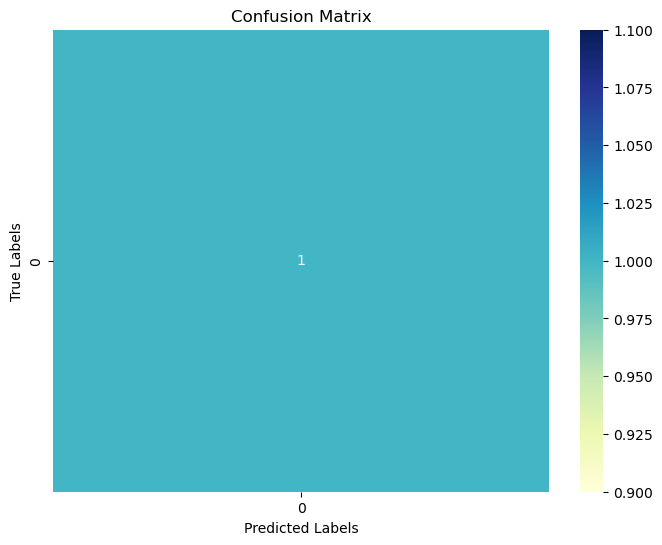

Precision: 1.0
Average precision: 1.0


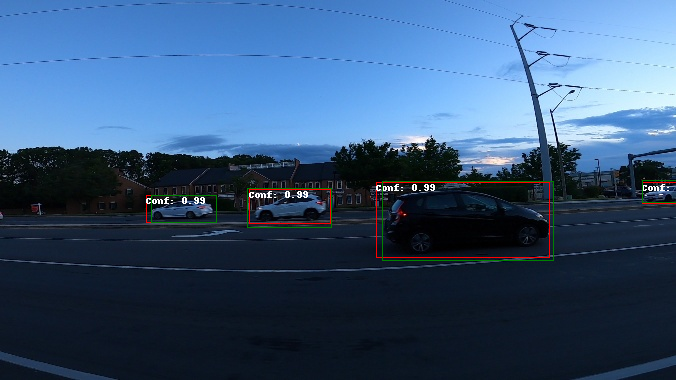

tensor([1, 1, 1, 1], device='cuda:0')
tensor([[0.0000, 0.8366, 0.0000, 0.0000],
        [0.8980, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.9110, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.8314]], device='cuda:0',
       grad_fn=<DivBackward0>)
tensor([1, 0, 2, 3], device='cuda:0')
tensor([0.8366, 0.8980, 0.9110, 0.8314], device='cuda:0',
       grad_fn=<IndexBackward0>)


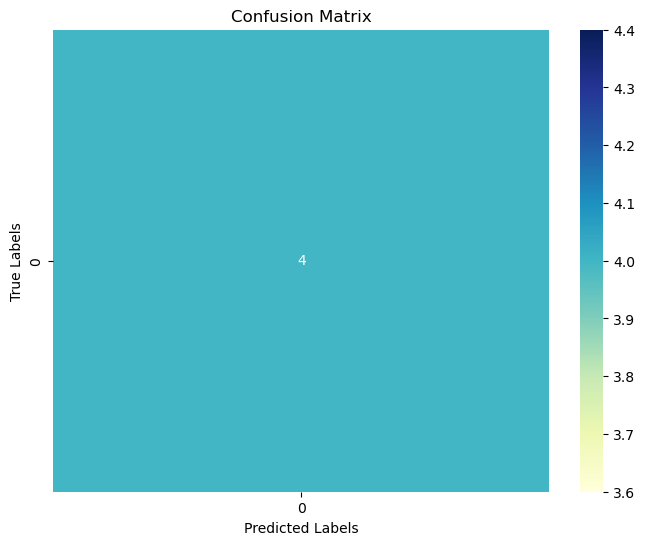

Precision: 1.0
Average precision: 1.0


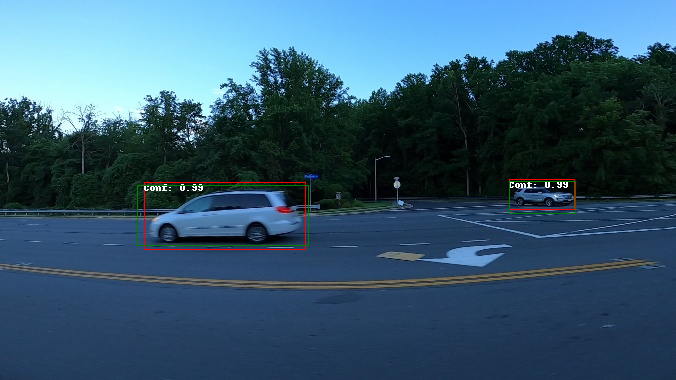

tensor([1, 1], device='cuda:0')
tensor([[0.0000, 0.8481],
        [0.8548, 0.0000]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([1, 0], device='cuda:0')
tensor([0.8481, 0.8548], device='cuda:0', grad_fn=<IndexBackward0>)


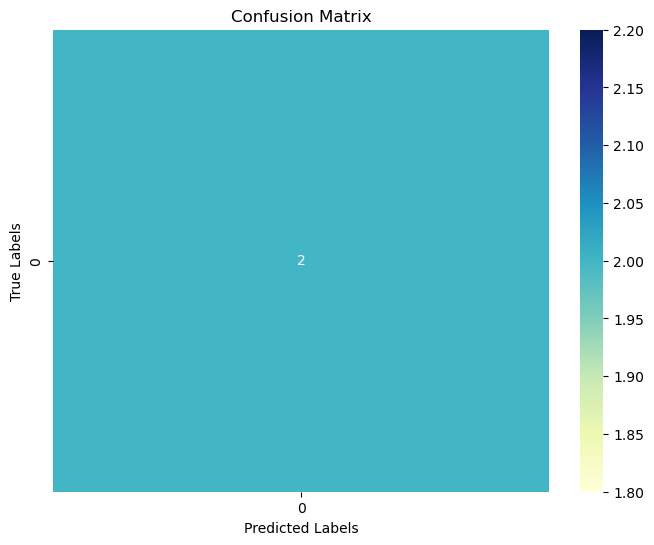

Precision: 1.0
Average precision: 1.0


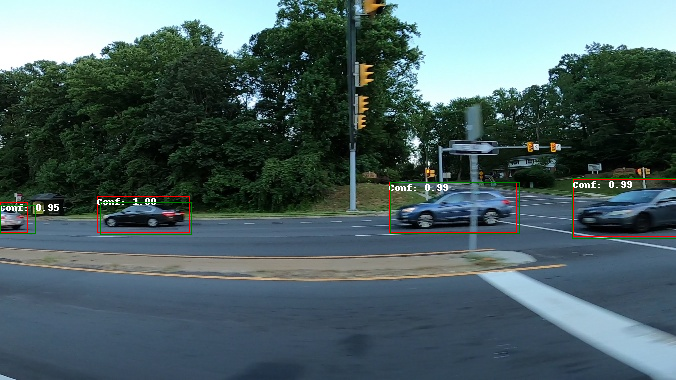

tensor([1, 1, 1, 1], device='cuda:0')
tensor([[0.7821, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.9573, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.9403],
        [0.0000, 0.7155, 0.0000, 0.0000]], device='cuda:0',
       grad_fn=<DivBackward0>)
tensor([0, 2, 3, 1], device='cuda:0')
tensor([0.7821, 0.9573, 0.9403, 0.7155], device='cuda:0',
       grad_fn=<IndexBackward0>)


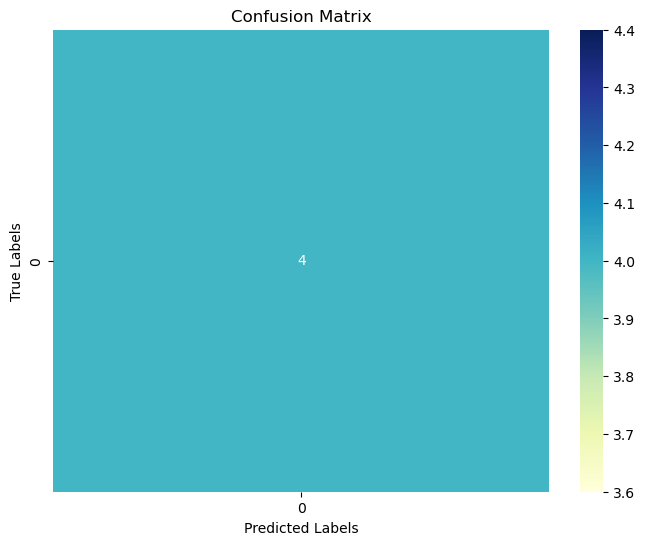

Precision: 1.0
Average precision: 1.0


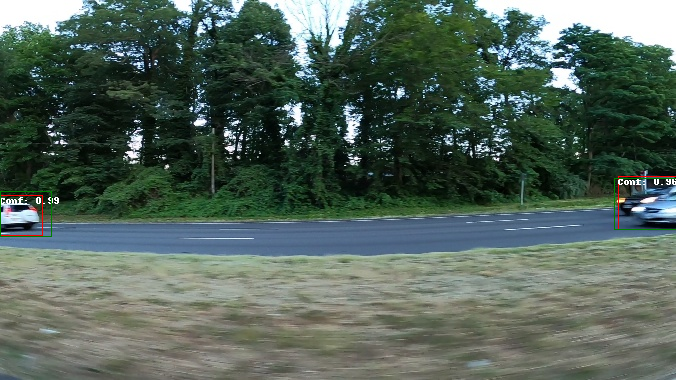

tensor([1, 1], device='cuda:0')
tensor([[0.7252, 0.0000],
        [0.0000, 0.8867]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0, 1], device='cuda:0')
tensor([0.7252, 0.8867], device='cuda:0', grad_fn=<IndexBackward0>)


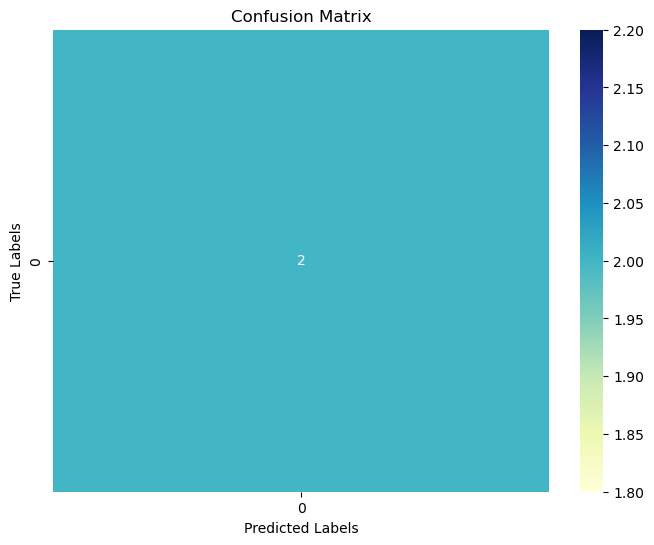

Precision: 1.0
Average precision: 1.0


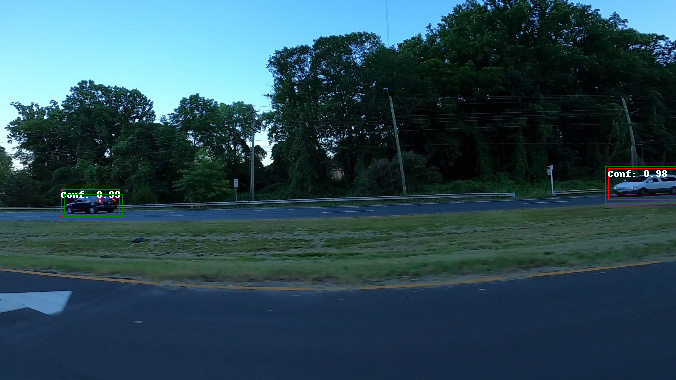

tensor([1, 1], device='cuda:0')
tensor([[0.7521, 0.0000],
        [0.0000, 0.7864]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0, 1], device='cuda:0')
tensor([0.7521, 0.7864], device='cuda:0', grad_fn=<IndexBackward0>)


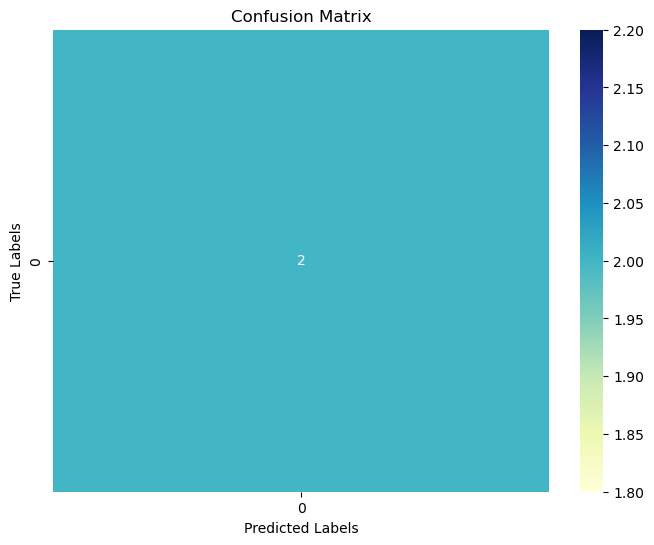

Precision: 1.0
Average precision: 1.0


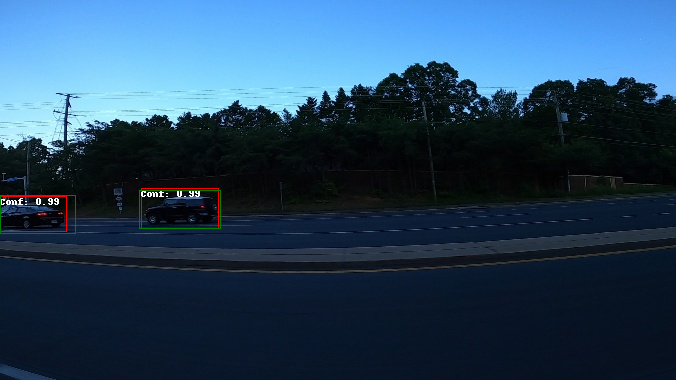

tensor([1, 1], device='cuda:0')
tensor([[0.0000, 0.9119],
        [0.8372, 0.0000]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([1, 0], device='cuda:0')
tensor([0.9119, 0.8372], device='cuda:0', grad_fn=<IndexBackward0>)


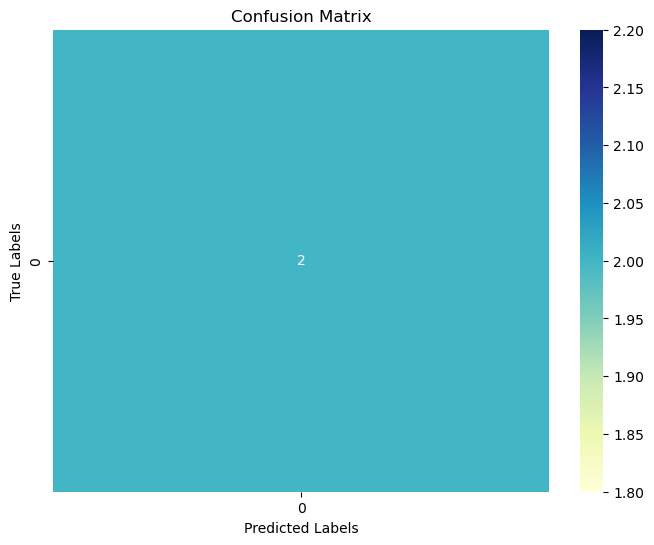

Precision: 1.0
Average precision: 1.0


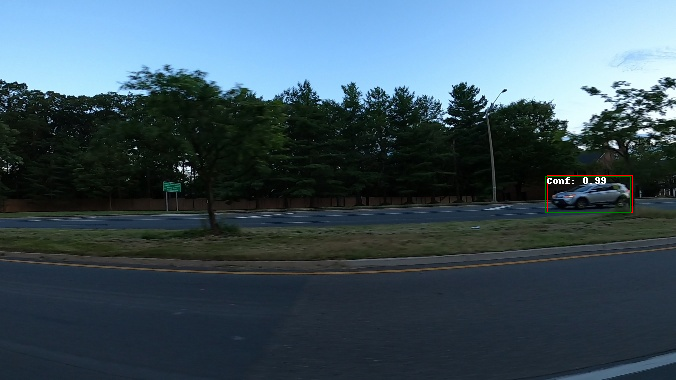

tensor([1], device='cuda:0')
tensor([[0.9243]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.9243], device='cuda:0', grad_fn=<IndexBackward0>)


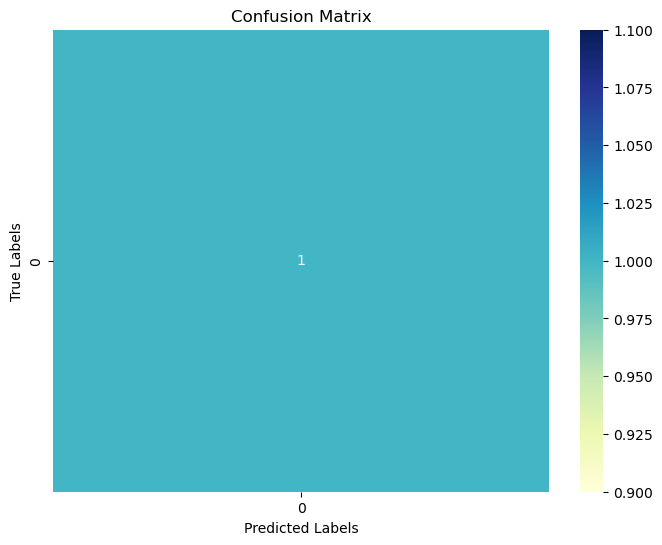

Precision: 1.0
Average precision: 1.0


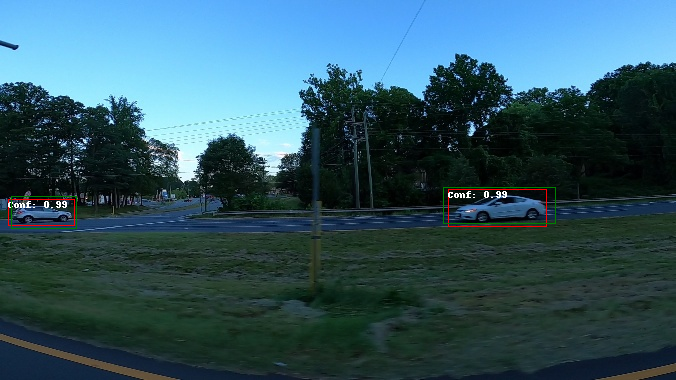

tensor([1, 1], device='cuda:0')
tensor([[0.7470, 0.0000],
        [0.0000, 0.7543]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0, 1], device='cuda:0')
tensor([0.7470, 0.7543], device='cuda:0', grad_fn=<IndexBackward0>)


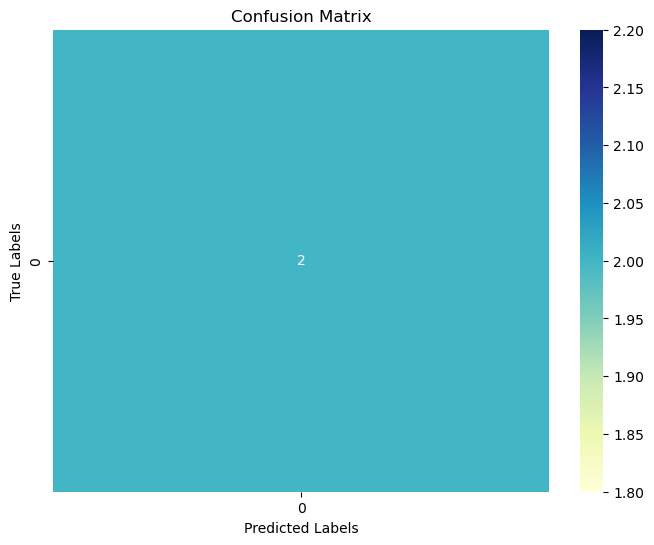

Precision: 1.0
Average precision: 1.0


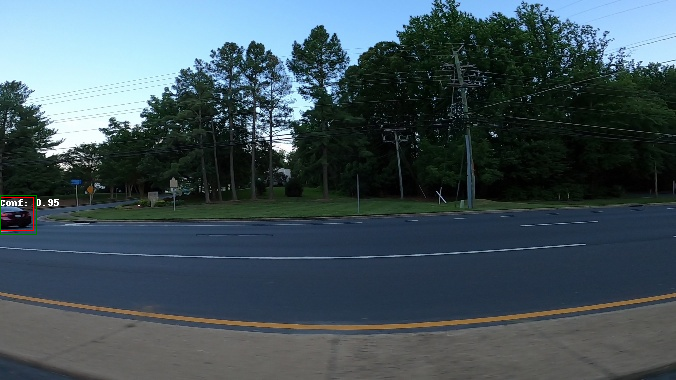

tensor([1], device='cuda:0')
tensor([[0.8047]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8047], device='cuda:0', grad_fn=<IndexBackward0>)


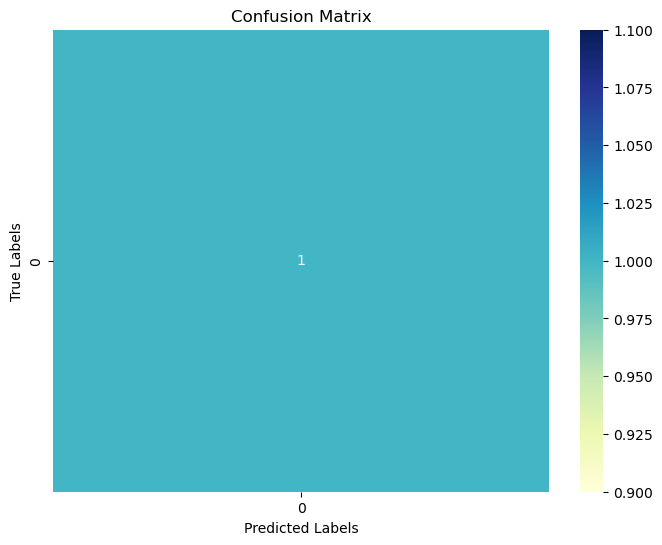

Precision: 1.0
Average precision: 1.0


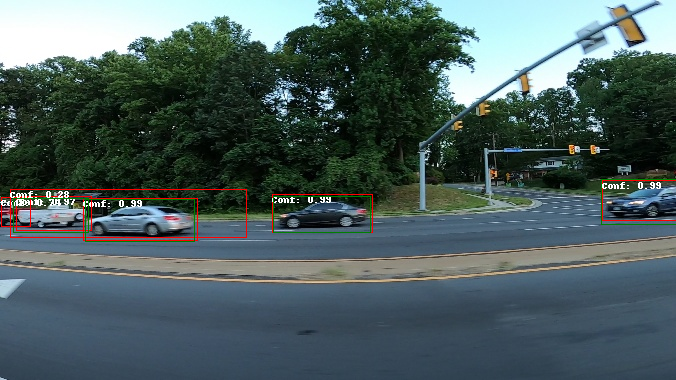

tensor([1, 1, 1, 1], device='cuda:0')
tensor([[0.0000, 0.0000, 0.9389, 0.0000],
        [0.0209, 0.9282, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.8703],
        [0.8192, 0.0287, 0.0000, 0.0000],
        [0.1797, 0.0000, 0.0000, 0.0000],
        [0.2249, 0.3606, 0.0000, 0.0000]], device='cuda:0',
       grad_fn=<DivBackward0>)
tensor([2, 1, 3, 0, 0, 1], device='cuda:0')
tensor([0.9389, 0.9282, 0.8703, 0.8192, 0.1797, 0.3606], device='cuda:0',
       grad_fn=<IndexBackward0>)


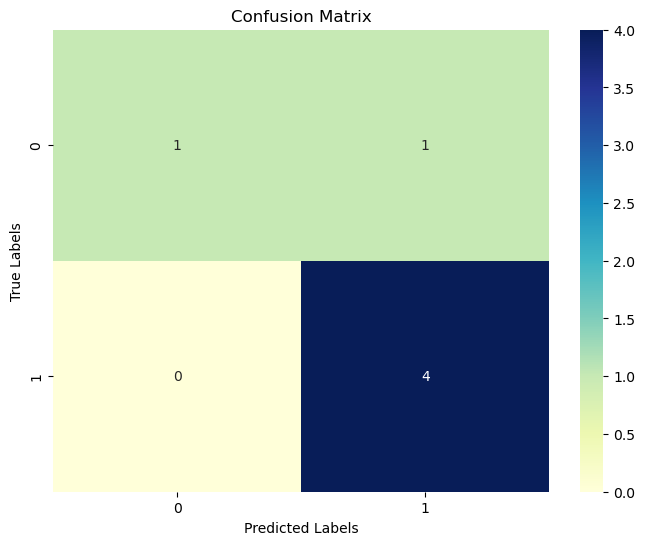

Precision: 0.6666666666666666
Average precision: 0.8


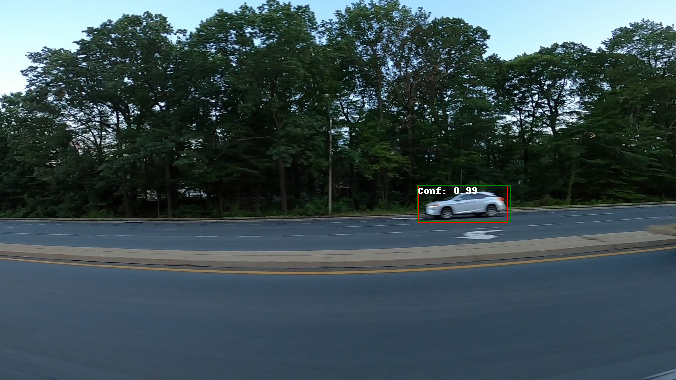

tensor([1], device='cuda:0')
tensor([[0.9199]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.9199], device='cuda:0', grad_fn=<IndexBackward0>)


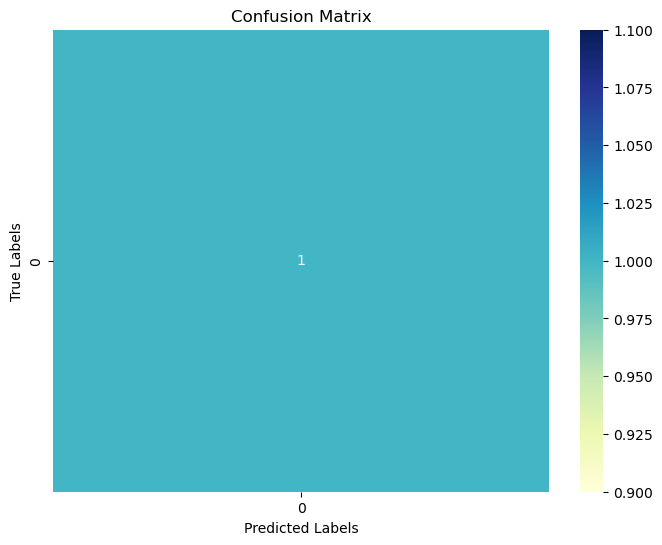

Precision: 1.0
Average precision: 1.0


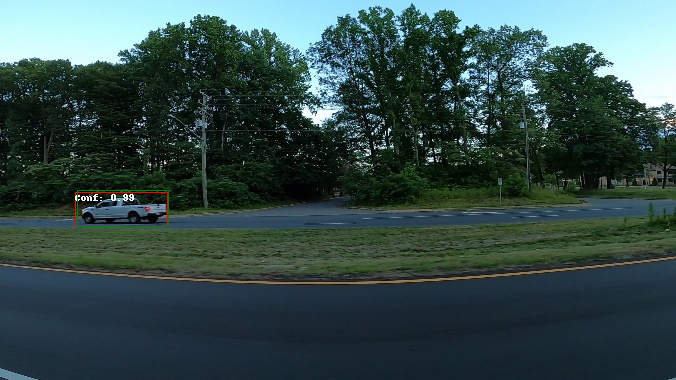

tensor([1], device='cuda:0')
tensor([[0.8930]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8930], device='cuda:0', grad_fn=<IndexBackward0>)


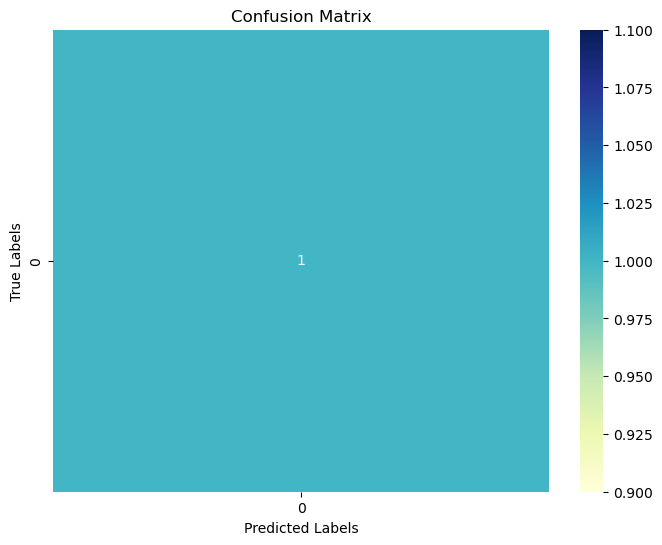

Precision: 1.0
Average precision: 1.0


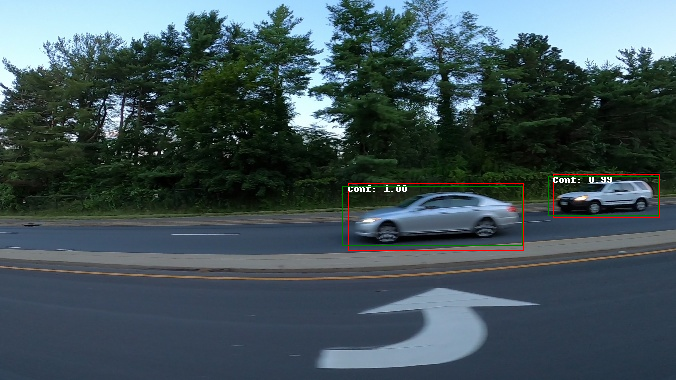

tensor([1, 1], device='cuda:0')
tensor([[0.8427, 0.0000],
        [0.0000, 0.8569]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0, 1], device='cuda:0')
tensor([0.8427, 0.8569], device='cuda:0', grad_fn=<IndexBackward0>)


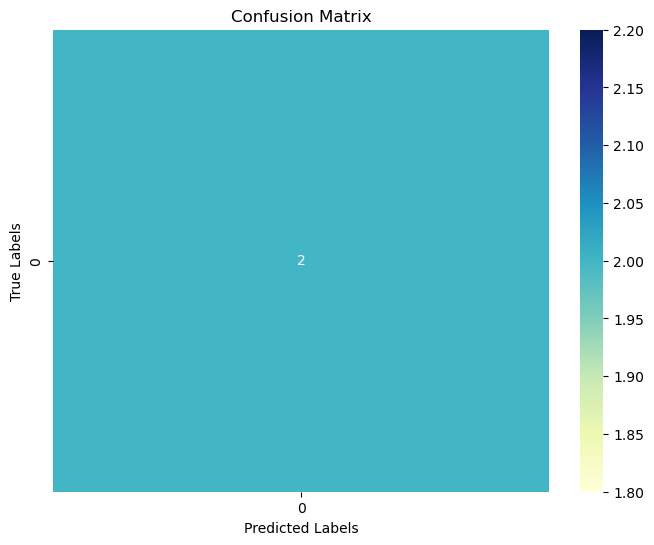

Precision: 1.0
Average precision: 1.0


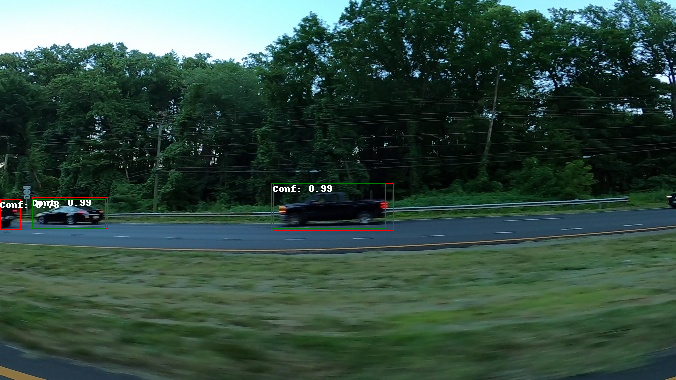

tensor([1, 1], device='cuda:0')
tensor([[0.8553, 0.0000],
        [0.0000, 0.8958],
        [0.0000, 0.0000]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0, 1, 0], device='cuda:0')
tensor([0.8553, 0.8958, 0.0000], device='cuda:0', grad_fn=<IndexBackward0>)


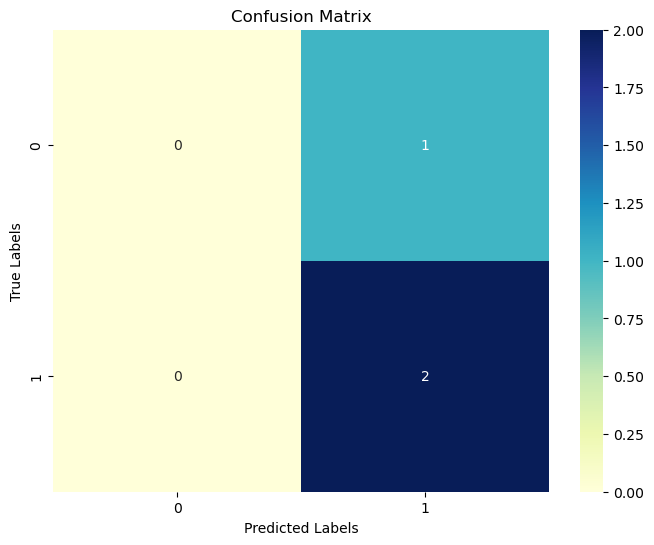

Precision: 0.6666666666666666
Average precision: 0.6666666666666666


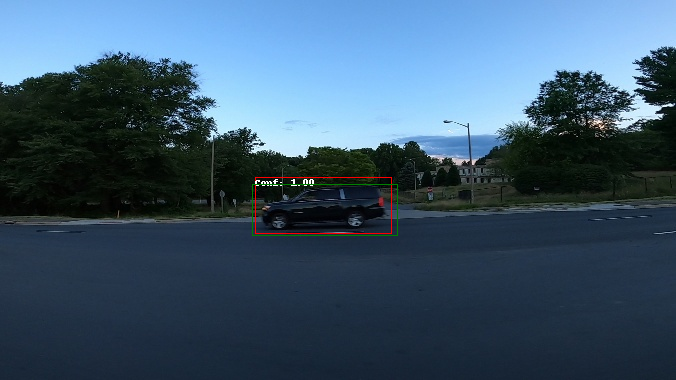

tensor([1], device='cuda:0')
tensor([[0.8178]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8178], device='cuda:0', grad_fn=<IndexBackward0>)


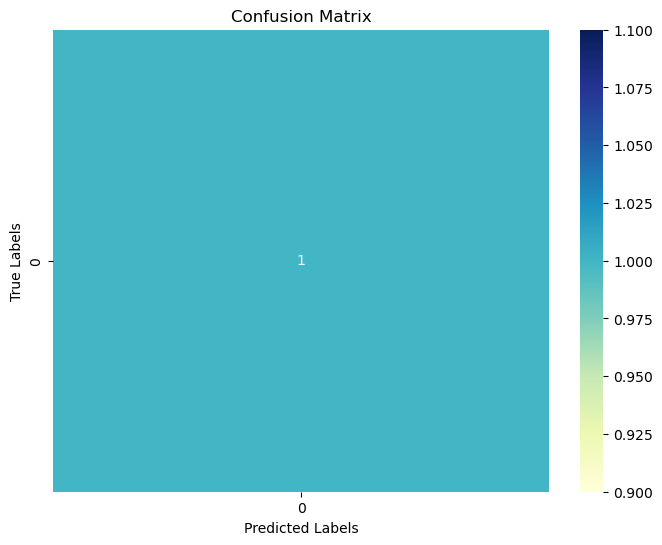

Precision: 1.0
Average precision: 1.0


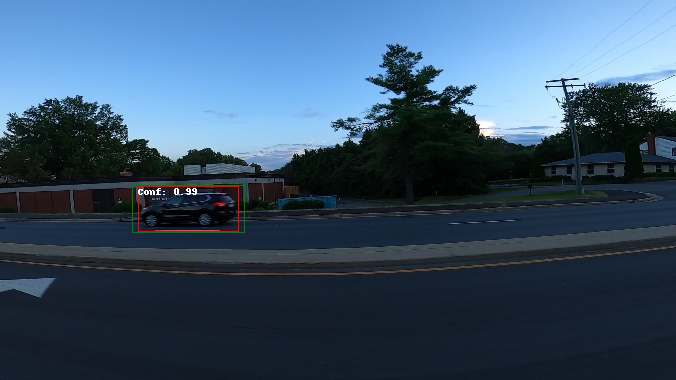

tensor([1], device='cuda:0')
tensor([[0.8524]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8524], device='cuda:0', grad_fn=<IndexBackward0>)


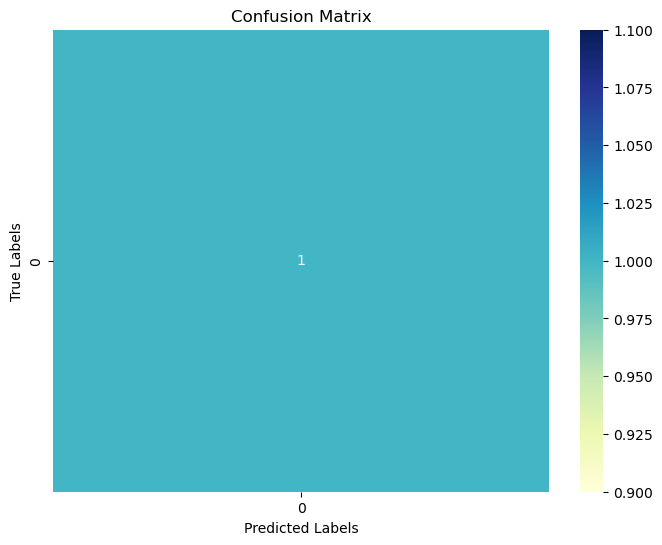

Precision: 1.0
Average precision: 1.0


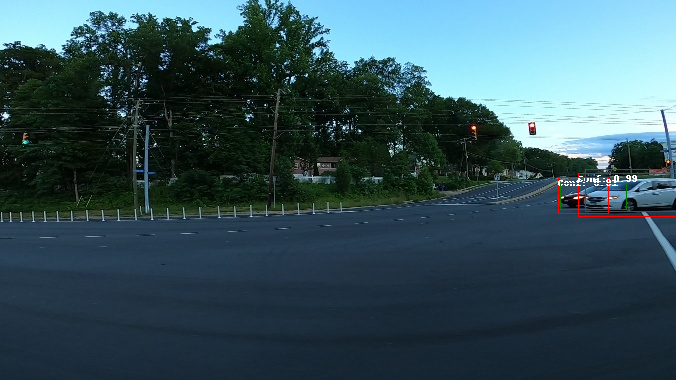

tensor([1, 1], device='cuda:0')
tensor([[0.2625, 0.7354],
        [0.5705, 0.1647]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([1, 0], device='cuda:0')
tensor([0.7354, 0.5705], device='cuda:0', grad_fn=<IndexBackward0>)


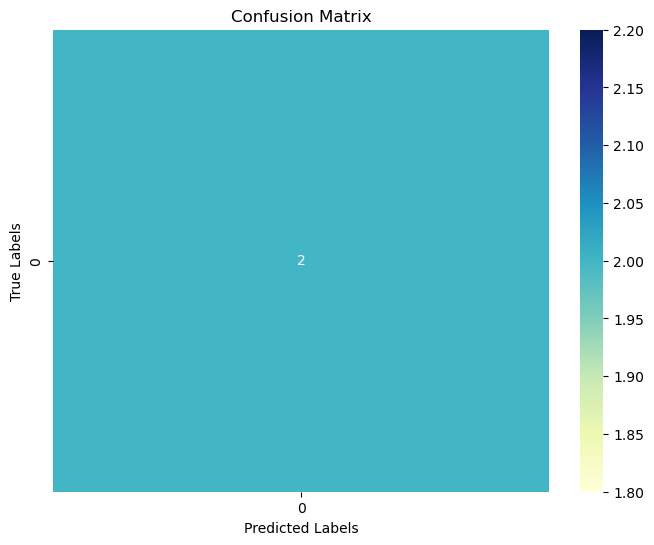

Precision: 1.0
Average precision: 1.0


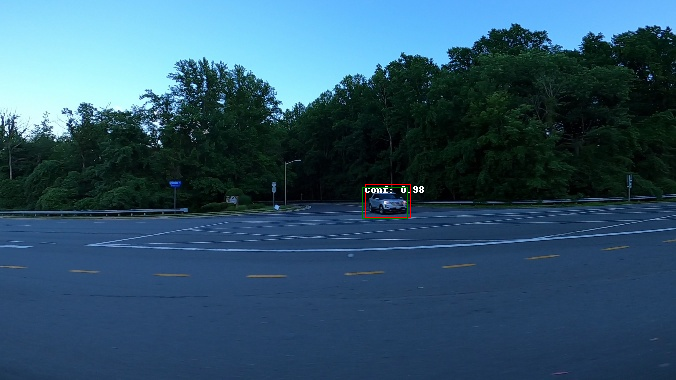

tensor([1], device='cuda:0')
tensor([[0.7825]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.7825], device='cuda:0', grad_fn=<IndexBackward0>)


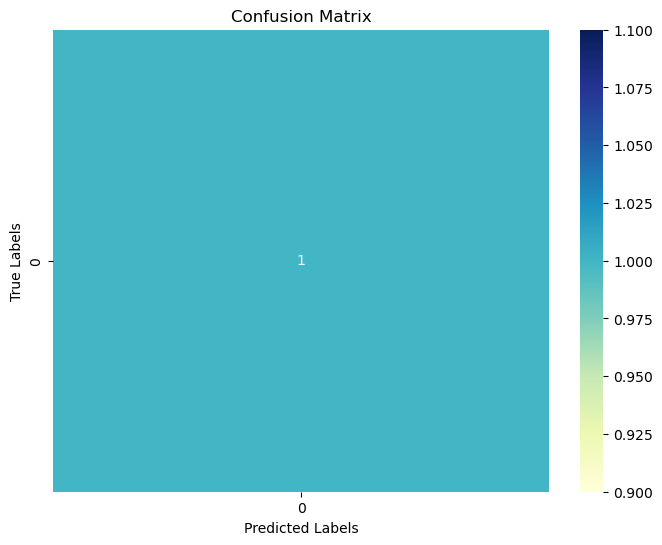

Precision: 1.0
Average precision: 1.0


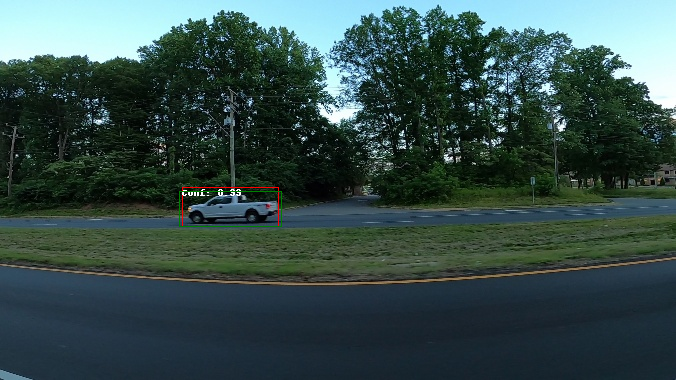

tensor([1], device='cuda:0')
tensor([[0.8550]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8550], device='cuda:0', grad_fn=<IndexBackward0>)


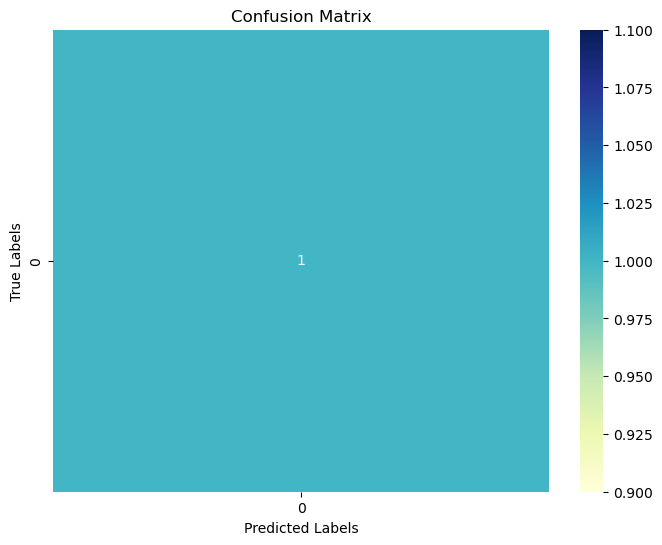

Precision: 1.0
Average precision: 1.0


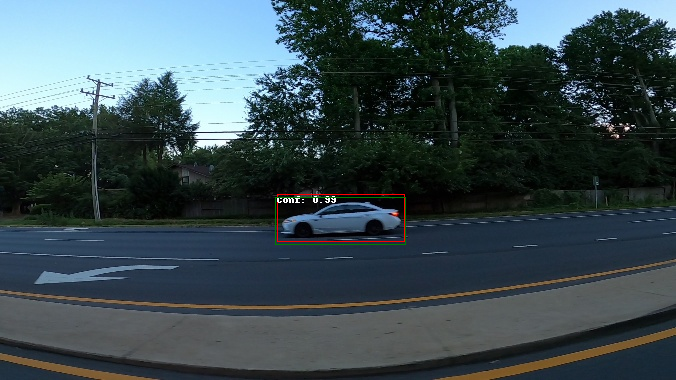

tensor([1], device='cuda:0')
tensor([[0.8807]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8807], device='cuda:0', grad_fn=<IndexBackward0>)


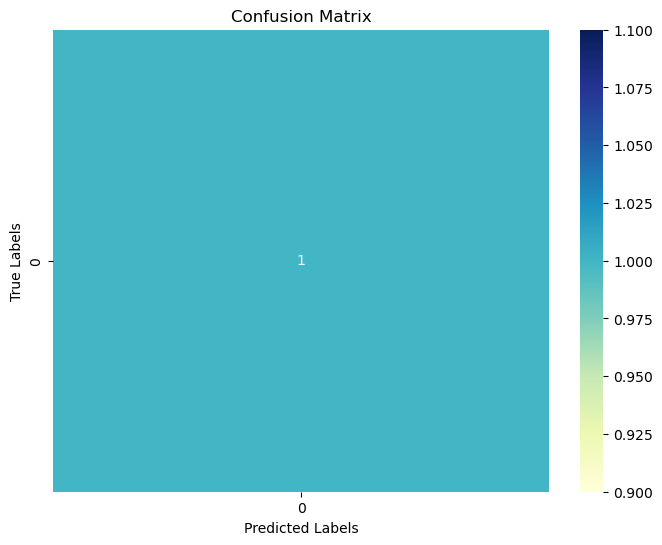

Precision: 1.0
Average precision: 1.0


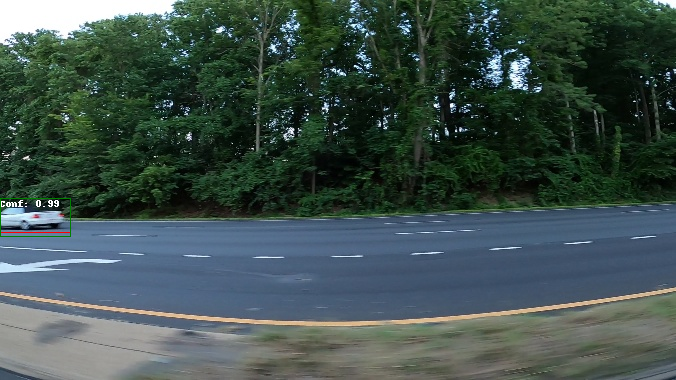

tensor([1], device='cuda:0')
tensor([[0.8823]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8823], device='cuda:0', grad_fn=<IndexBackward0>)


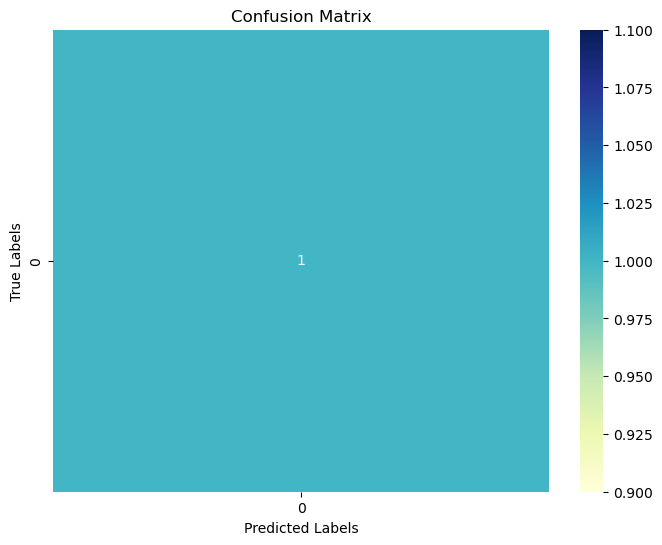

Precision: 1.0
Average precision: 1.0


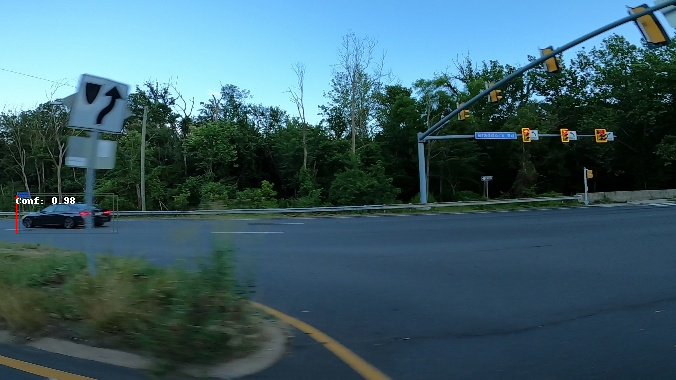

tensor([1], device='cuda:0')
tensor([[0.8713]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8713], device='cuda:0', grad_fn=<IndexBackward0>)


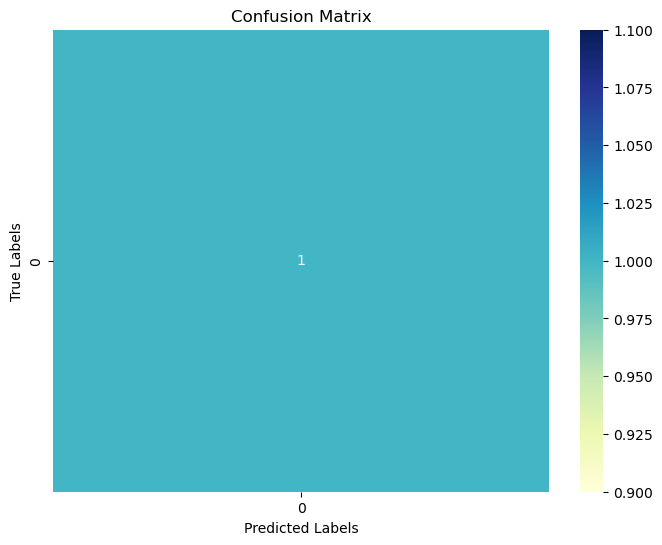

Precision: 1.0
Average precision: 1.0


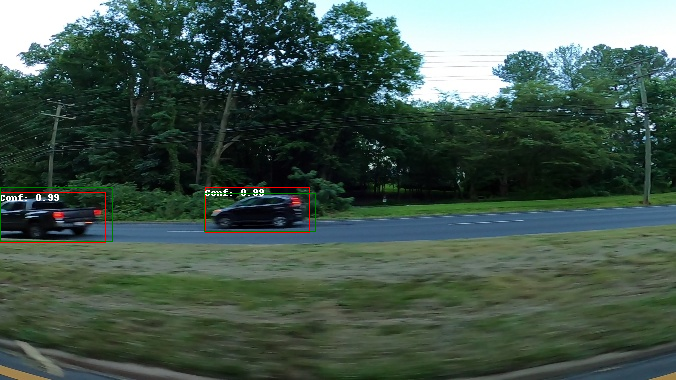

tensor([1, 1], device='cuda:0')
tensor([[0.7939, 0.0000],
        [0.0000, 0.8287]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0, 1], device='cuda:0')
tensor([0.7939, 0.8287], device='cuda:0', grad_fn=<IndexBackward0>)


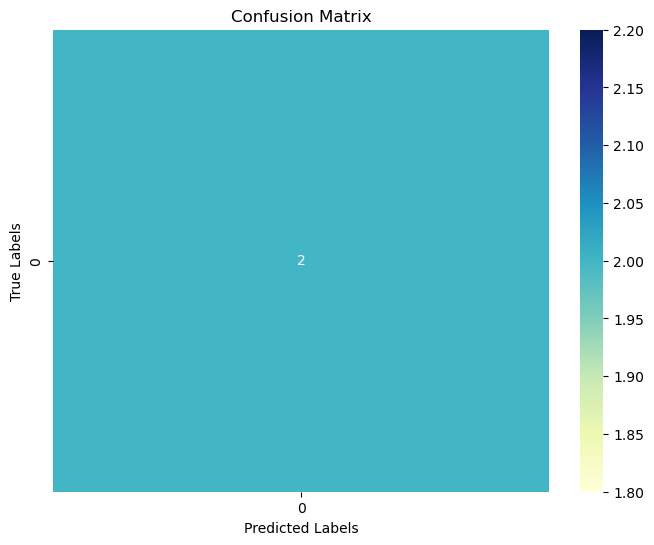

Precision: 1.0
Average precision: 1.0


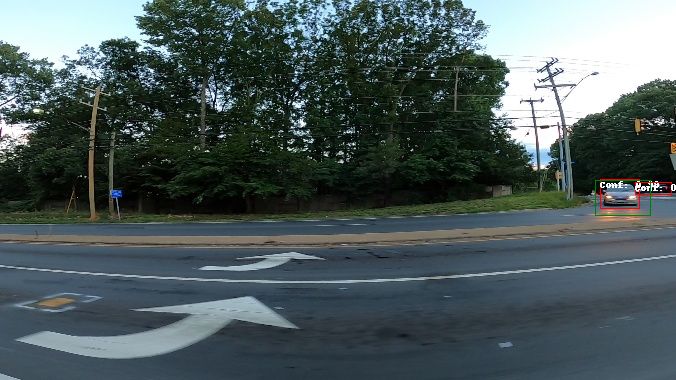

tensor([1], device='cuda:0')
tensor([[0.5762],
        [0.0845]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0, 0], device='cuda:0')
tensor([0.5762, 0.0845], device='cuda:0', grad_fn=<IndexBackward0>)


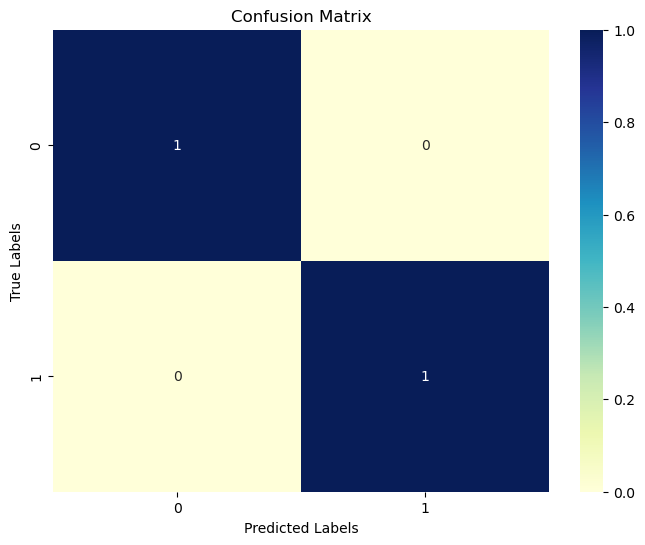

Precision: 0.5
Average precision: 1.0


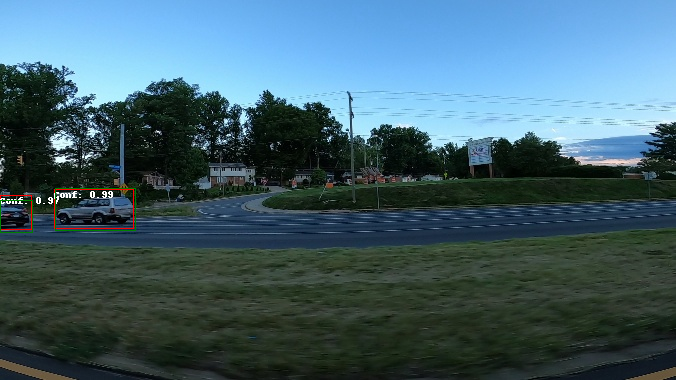

tensor([1, 1], device='cuda:0')
tensor([[0.9187, 0.0000],
        [0.0000, 0.7789]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0, 1], device='cuda:0')
tensor([0.9187, 0.7789], device='cuda:0', grad_fn=<IndexBackward0>)


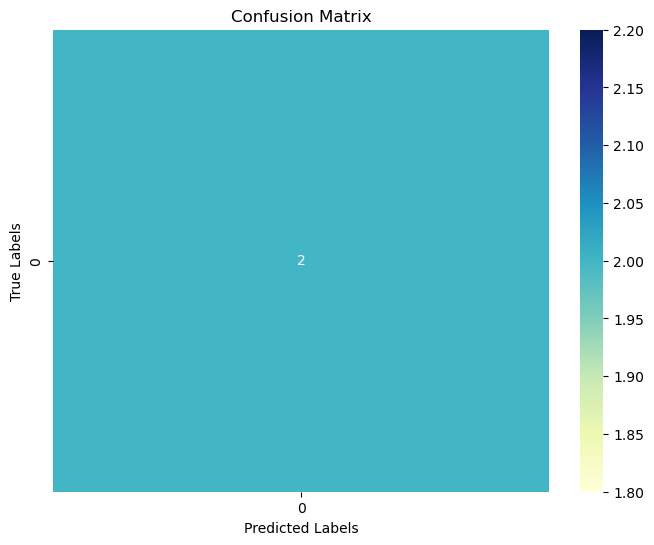

Precision: 1.0
Average precision: 1.0


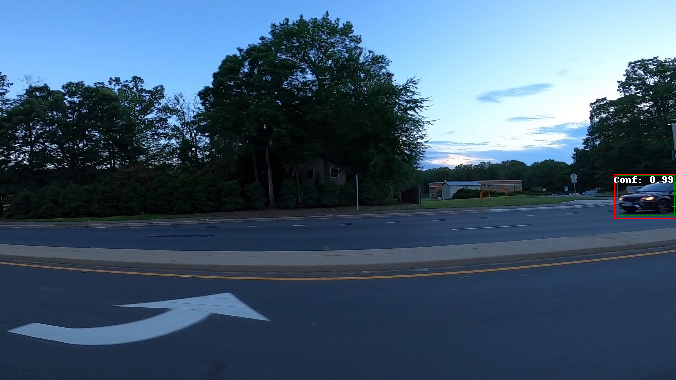

tensor([1], device='cuda:0')
tensor([[0.8595]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8595], device='cuda:0', grad_fn=<IndexBackward0>)


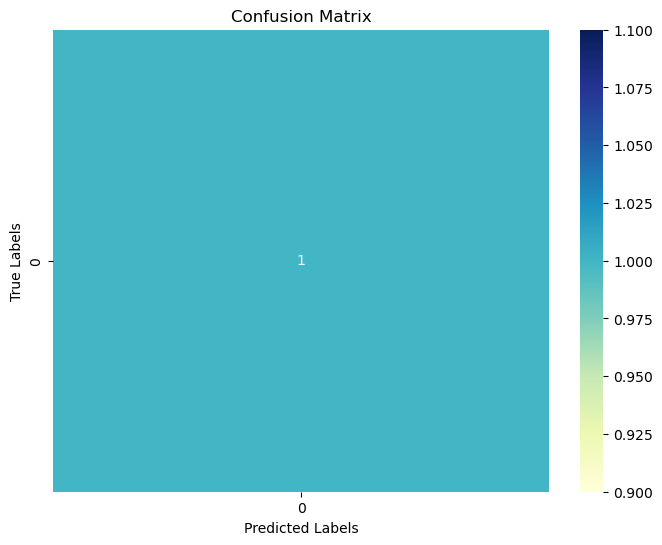

Precision: 1.0
Average precision: 1.0


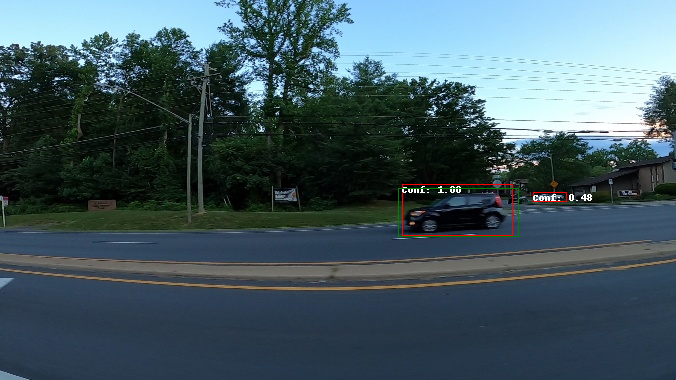

tensor([1], device='cuda:0')
tensor([[0.8517],
        [0.0000]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0, 0], device='cuda:0')
tensor([0.8517, 0.0000], device='cuda:0', grad_fn=<IndexBackward0>)


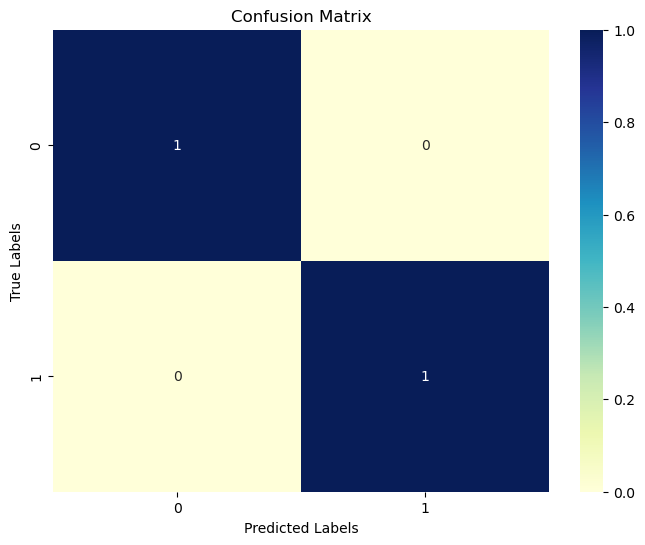

Precision: 0.5
Average precision: 1.0


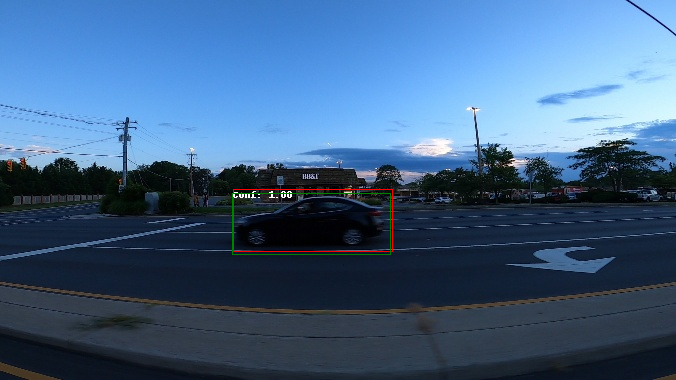

tensor([1], device='cuda:0')
tensor([[0.8875]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8875], device='cuda:0', grad_fn=<IndexBackward0>)


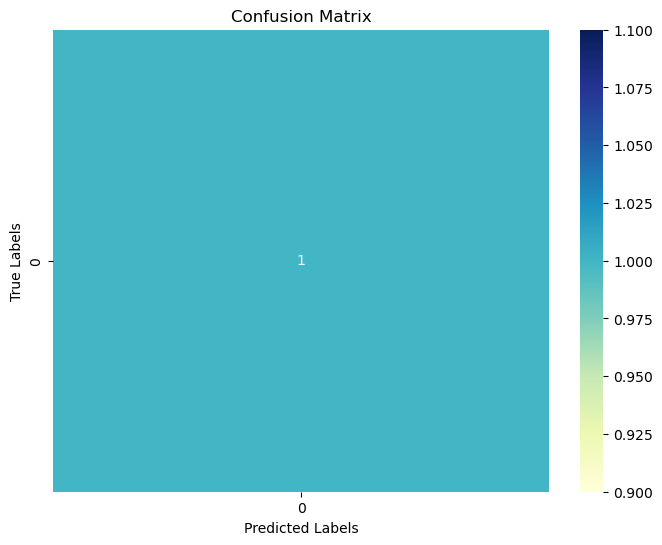

Precision: 1.0
Average precision: 1.0


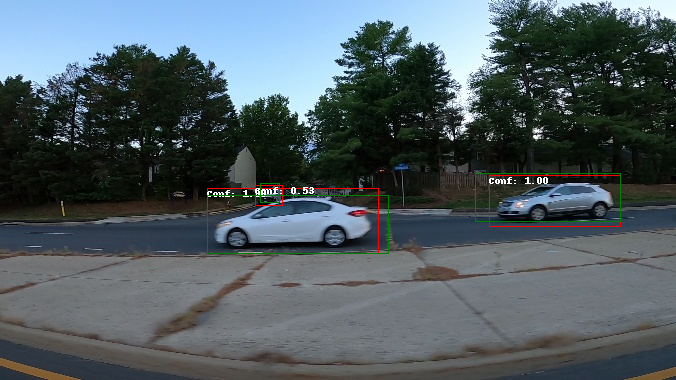

tensor([1, 1, 1], device='cuda:0')
tensor([[0.0226, 0.8462, 0.0000],
        [0.0000, 0.0000, 0.7610],
        [0.5436, 0.0250, 0.0000]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([1, 2, 0], device='cuda:0')
tensor([0.8462, 0.7610, 0.5436], device='cuda:0', grad_fn=<IndexBackward0>)


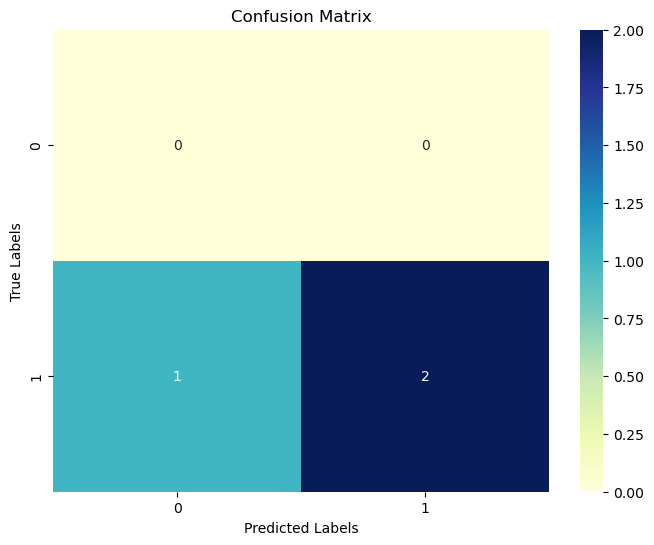

Precision: 1.0
Average precision: 1.0


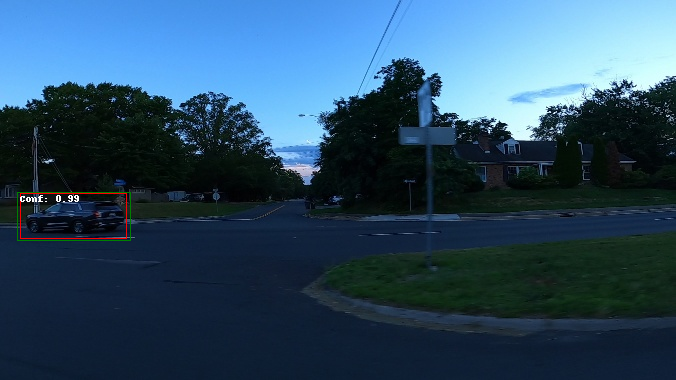

tensor([1], device='cuda:0')
tensor([[0.8799]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8799], device='cuda:0', grad_fn=<IndexBackward0>)


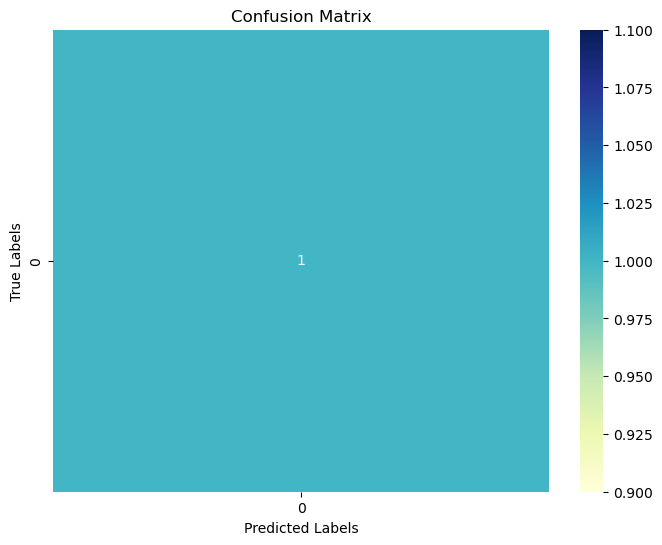

Precision: 1.0
Average precision: 1.0


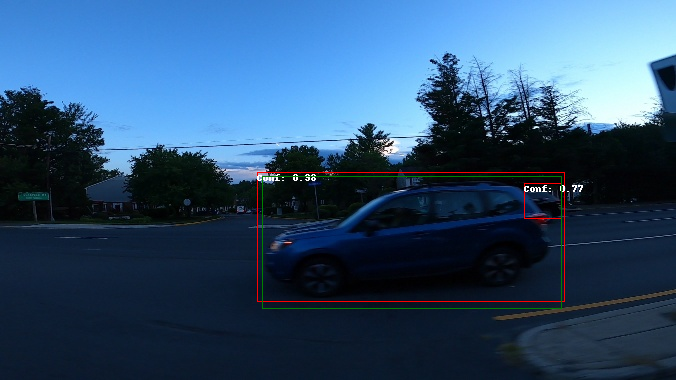

tensor([1], device='cuda:0')
tensor([[0.8984],
        [0.0317]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0, 0], device='cuda:0')
tensor([0.8984, 0.0317], device='cuda:0', grad_fn=<IndexBackward0>)


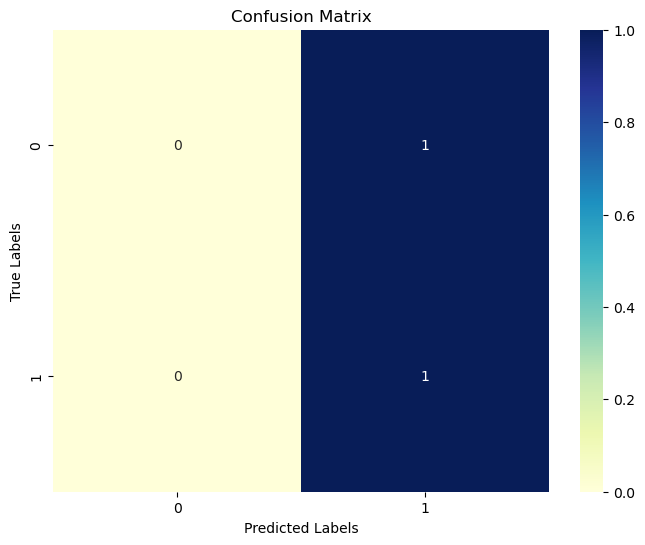

Precision: 0.5
Average precision: 0.5


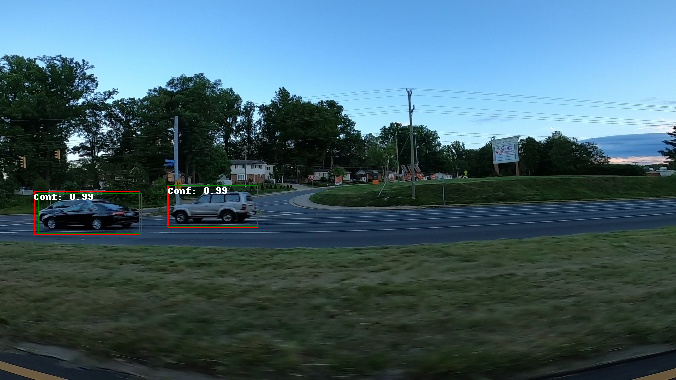

tensor([1, 1], device='cuda:0')
tensor([[0.8810, 0.0000],
        [0.0000, 0.9415]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0, 1], device='cuda:0')
tensor([0.8810, 0.9415], device='cuda:0', grad_fn=<IndexBackward0>)


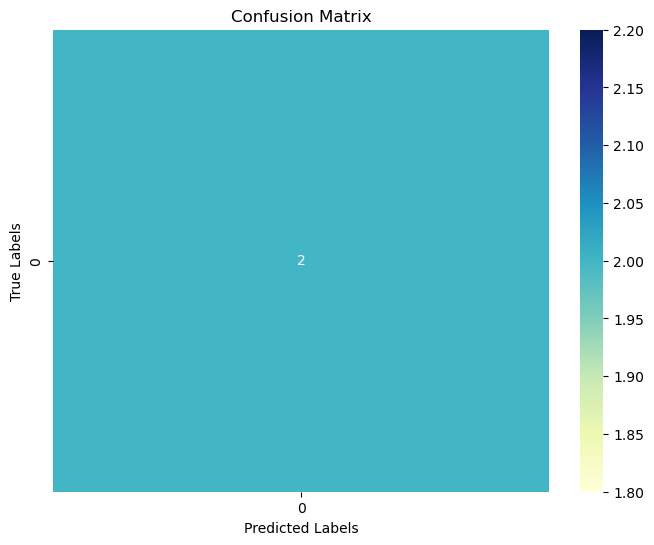

Precision: 1.0
Average precision: 1.0


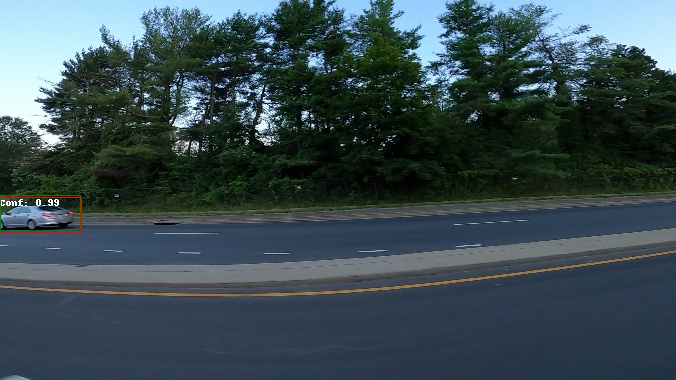

tensor([1], device='cuda:0')
tensor([[0.8645]], device='cuda:0', grad_fn=<DivBackward0>)
tensor([0], device='cuda:0')
tensor([0.8645], device='cuda:0', grad_fn=<IndexBackward0>)


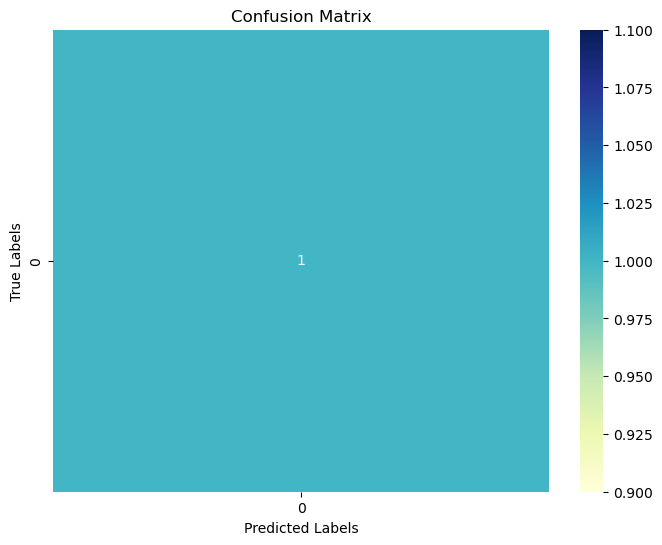

Precision: 1.0
Average precision: 1.0
precision_mean:  0.9398148148148147
ap_mean:  0.9712962962962963


In [ ]:
model.eval()
data=iter(test_dl).__next__()
disp_imgs(test_dl)

In [ ]:
import glob
jpgfiles = []
for file in glob.glob("/kaggle/input/car-object-detection/data/testing_images/*.jpg"):
    jpgfiles.append(file)

In [ ]:
test_imgs = []
for j in range(len(jpgfiles)):
    test_img = Image.open(jpgfiles[j]).convert('RGB')
    test_img = T.ToTensor()(test_img)
    test_imgs.append(test_img)



In [ ]:
print(len(test_imgs[:10]))

10


In [ ]:
def disp_test_imgs(dl):
    for k in range(len(dl)):
        output = model([dl[k].to(device)])
        out_bbox = output[0]["boxes"]
        out_scores = output[0]["scores"]
        keep = torchvision.ops.nms(out_bbox, out_scores, 0.45)
        im = (dl[k].permute(1, 2, 0).cpu().detach().numpy() * 255).astype('uint8')
        vtest = Image.fromarray(im)
        draw = ImageDraw.Draw(vtest)
        for box, score in zip(out_bbox[keep],out_scores[keep]):  # Draw rectangles and confidence scores.
                draw.rectangle(list(box), fill=None, outline="red")
                draw.text((box[0], box[1]), f"Conf: {score:.2f}", fill="white")
        display(vtest)

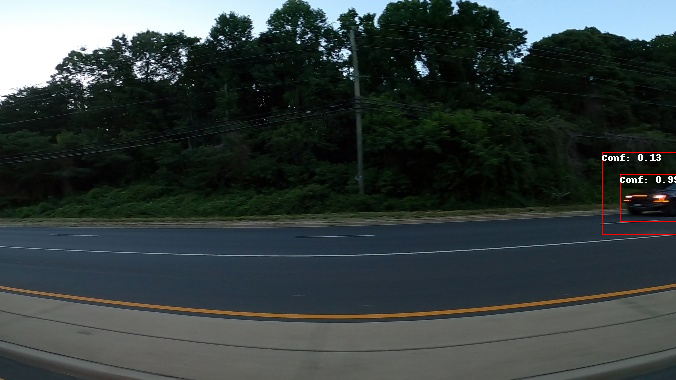

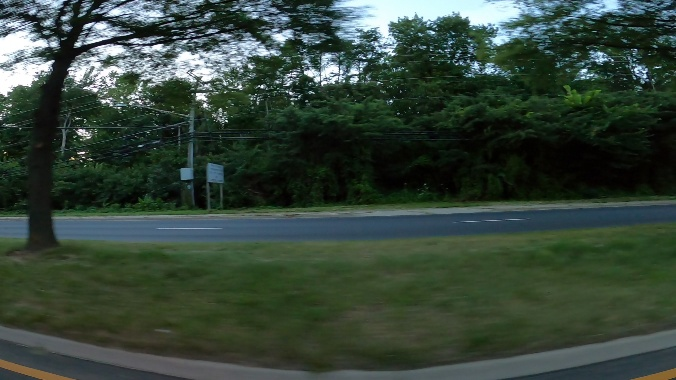

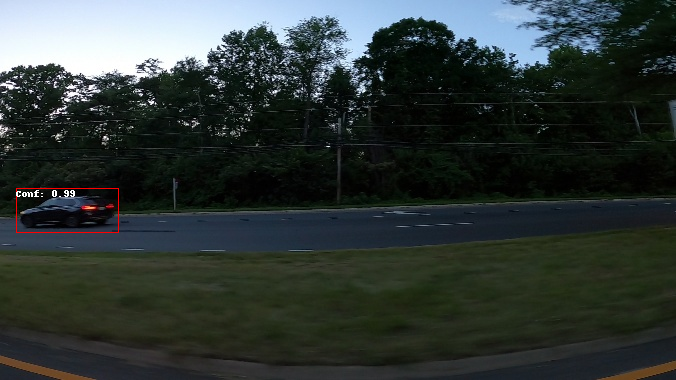

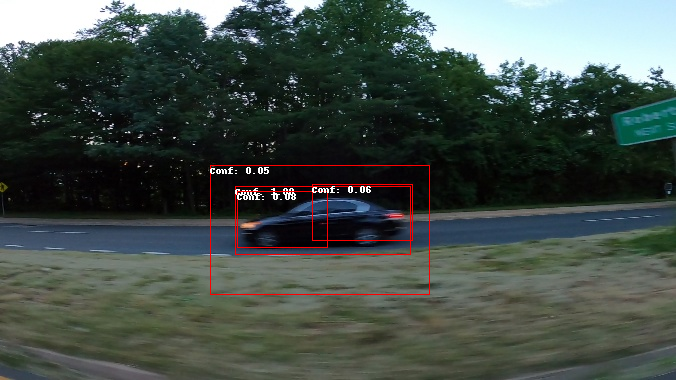

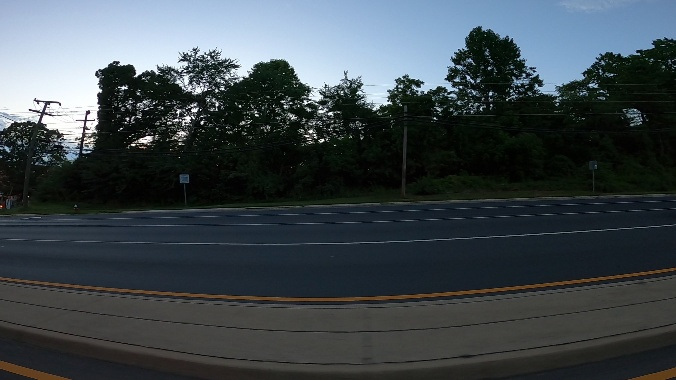

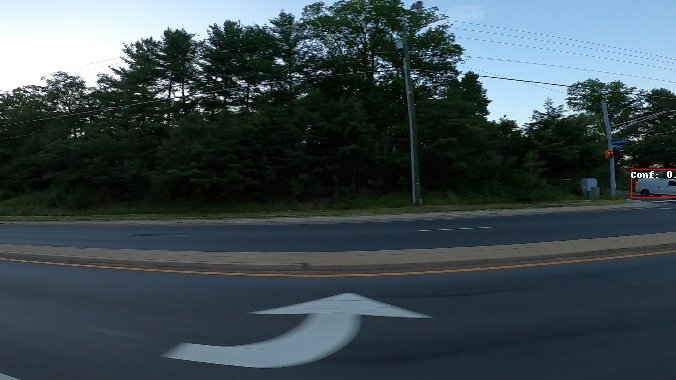

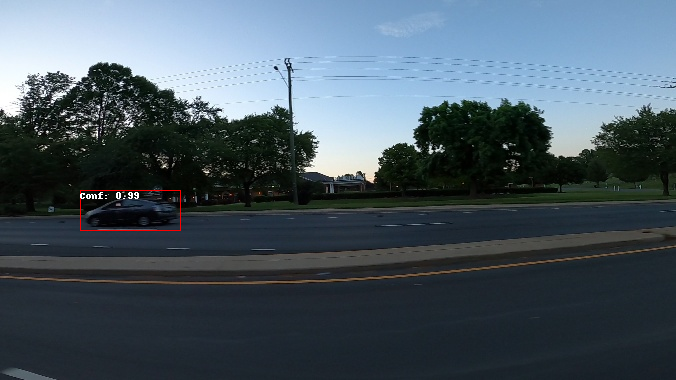

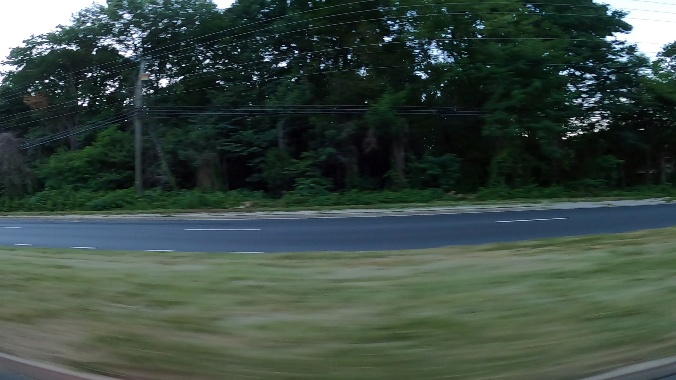

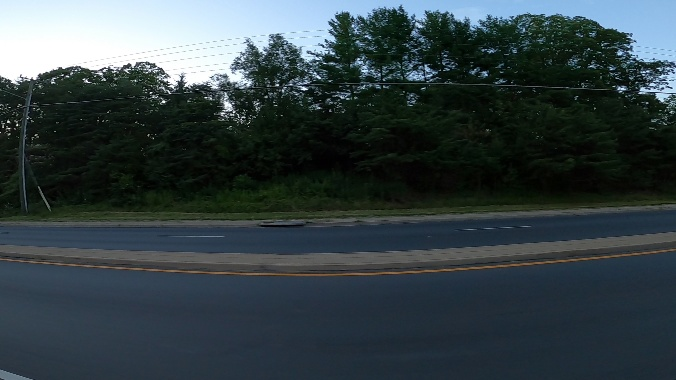

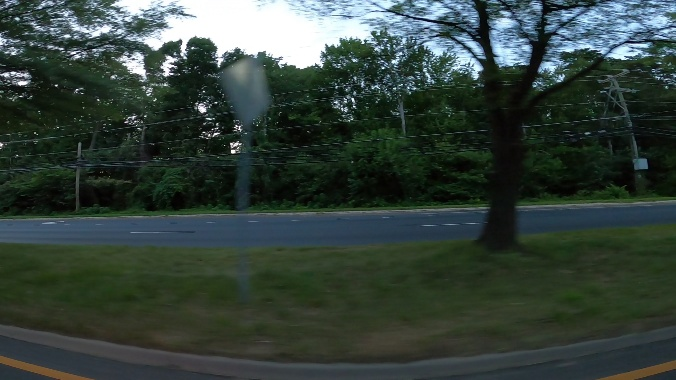

In [ ]:
np.random.shuffle(test_imgs)
disp_test_imgs(test_imgs[:10])
